# Introduction 
We had seen in the previous lesson, how to improve contrast in an image using simple intensity scaling approach. In this section, we will describe better ways of improving contrast in the image.

# Histogram Equalization
Histogram Equalization is a non-linear method for enhancing contrast in an image. We have already seen the theory in the video. Now, let's see how to perform histogram equalization using OpenCV using `equalizeHist()`.

#### Function Syntax
dst =   cv2.equalizeHist(   src[, dst]  )

##### Parameters:

`src` - Source 8-bit single channel image.

`dst` - Destination image of the same size and type as src .

In [1]:
import cv2
import matplotlib.pyplot as plt
from dataPath import DATA_PATH
import numpy as np
%matplotlib inline

In [2]:
import matplotlib
matplotlib.rcParams['figure.figsize'] = (50.0, 50.0)
matplotlib.rcParams['image.cmap'] = 'gray'
matplotlib.rcParams['axes.titlesize'] = 40
matplotlib.rcParams['image.interpolation'] = 'bilinear'

(-0.5, 541.5, 749.5, -0.5)

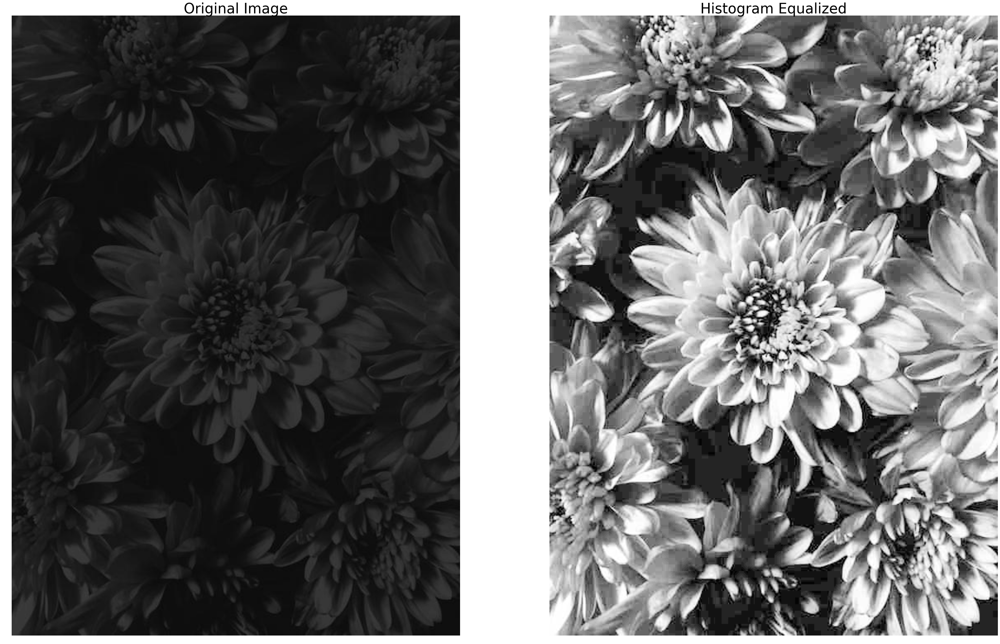

In [3]:
# Read image in grayscale format
filename = DATA_PATH+"images/dark-flowers.jpg"
im = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)

# Equalize histogram
imEq = cv2.equalizeHist(im)

#Display images
plt.figure()

ax = plt.subplot(1,2,1)
plt.imshow(im, vmin=0, vmax=255)
ax.set_title("Original Image")
ax.axis('off')


ax = plt.subplot(1,2,2)
plt.imshow(imEq, vmin=0, vmax=255)
ax.set_title("Histogram Equalized")
ax.axis('off')

#### Display Histogram
Now, let's look at the histogram of the two images. In the previous section we had used calcHist() to calculate histogram. Matplotlib provides an alternative way which has a slightly better syntax. Let's use it here.

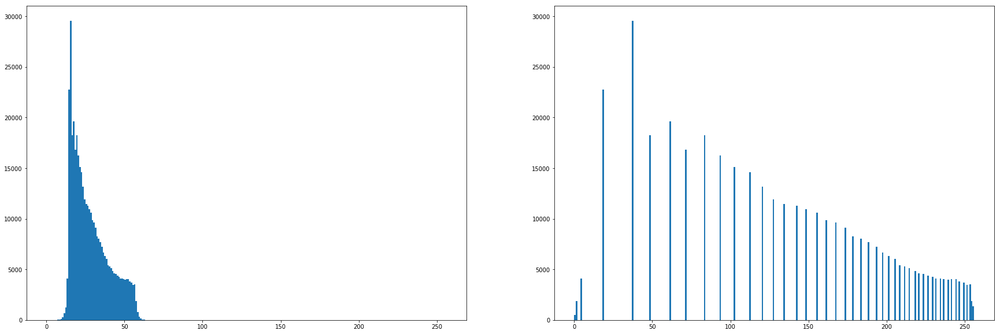

In [4]:
# Display histogram

plt.figure(figsize=(30,10))
plt.subplot(1,2,1)
plt.hist(im.ravel(),256,[0,256]); 

plt.subplot(1,2,2)
plt.hist(imEq.ravel(),256,[0,256]); 
plt.show()


###### The histogram is spread more uniformly over the range

## Histogram Equalization for Color Images
One may be tempted to think that we can simply perform histogram equalization for each channel separately. For understanding why it is not a good idea, let's simply implement and see why it is not a good idea.

##### Wrong Way

(-0.5, 541.5, 749.5, -0.5)

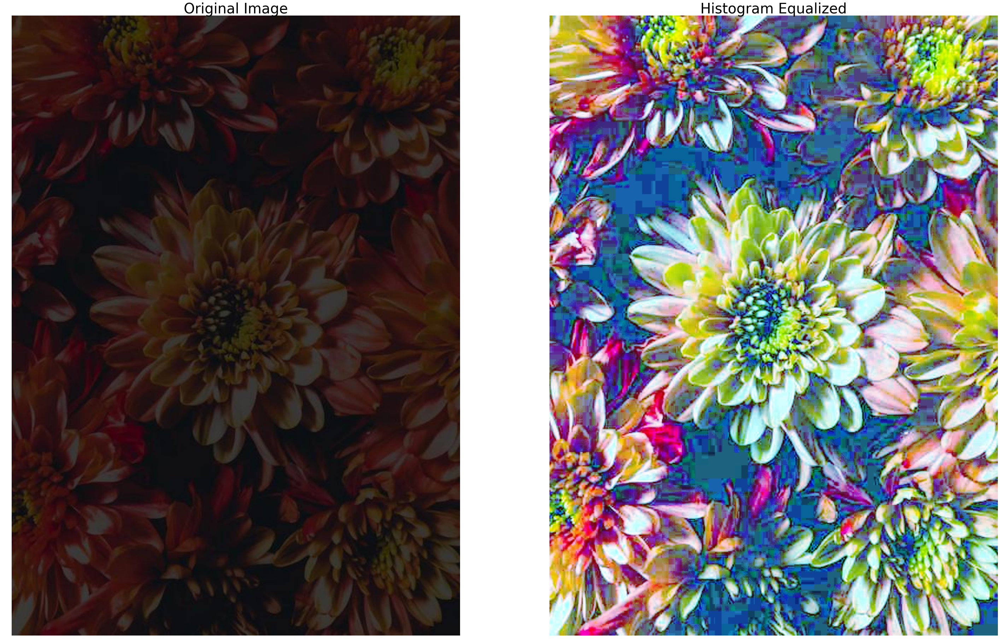

In [12]:
# Read color image
filename = DATA_PATH+"images/dark-flowers.jpg"
im = cv2.imread(filename)
imEq = np.zeros_like(im)

# Peform histogram equalization on each channel separately
for i in range(0,3):
    imEq[:,:,i] = cv2.equalizeHist(im[:,:,i])

#Display images
plt.figure()

ax = plt.subplot(1,2,1)
plt.imshow(im[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Original Image")
ax.axis('off')


ax = plt.subplot(1,2,2)
plt.imshow(imEq[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Histogram Equalized")
ax.axis('off') 

##### Right Way
We just saw that histogram equalization performed on the three channels separately leads to a bad results. The reason is that when each color channel is non-linearly transformed independently, you can get completely new and unrelated colors.

The right way to perform histogram equalization on color images is to transform the images to a space like the HSV colorspace where colors/hue/tint is separated from the intensity.

These are the steps involved

Tranform the image to HSV colorspace.
Perform histogram equalization only on the V channel.
Transform the image back to RGB colorspace.


(-0.5, 541.5, 749.5, -0.5)

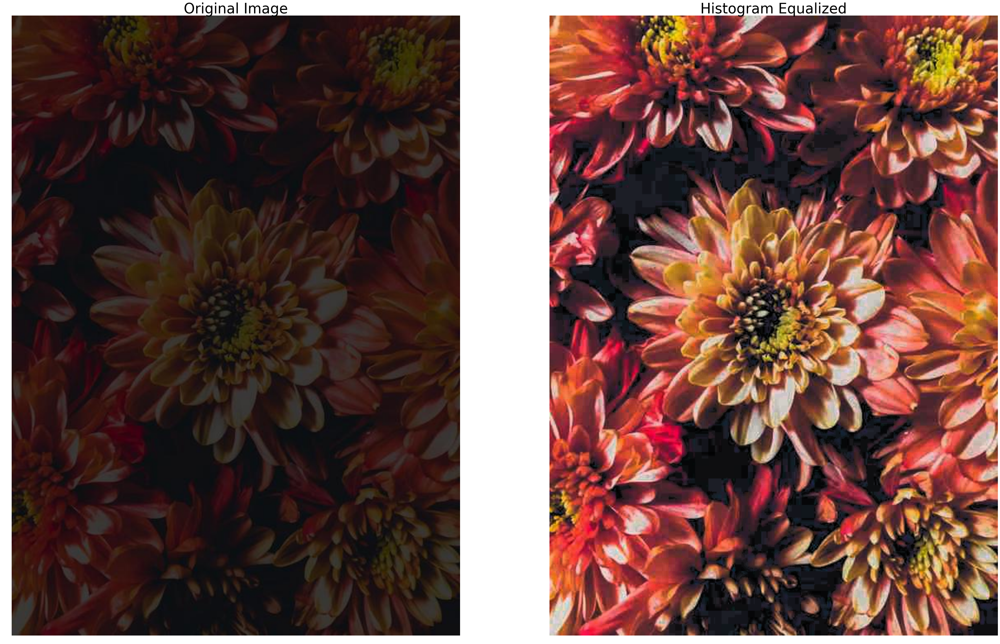

In [13]:
# Read color image
filename = DATA_PATH+"images/dark-flowers.jpg"
im = cv2.imread(filename)

# Convert to HSV 
imhsv = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)

# Perform histogram equalization only on the V channel
imhsv[:,:,2] = cv2.equalizeHist(imhsv[:,:,2])

# Convert back to BGR format
imEq = cv2.cvtColor(imhsv, cv2.COLOR_HSV2BGR)

#Display images
plt.figure()

ax = plt.subplot(1,2,1)
plt.imshow(im[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Original Image")
ax.axis('off')


ax = plt.subplot(1,2,2)
plt.imshow(imEq[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Histogram Equalized")
ax.axis('off')

## Contrast Limited Adaptive Histogram Equalization (CLAHE) 
Histogram equalization uses the pixels of the entire image to improve contrast. While this may look good in many cases, sometimes we may want to enhance the contrast locally so the image does not looks more natural and less dramatic.

For such applications, we use Contrast Limited Adaptive Histogram Equalization (CLAHE) which improves the local contrast. More importantly it allows us to specify the size of the neighborhood that is considered "local".

Let's pick a different image, where we may prefer CLAHE in place of regular histogram equalization.

(-0.5, 666.5, 999.5, -0.5)

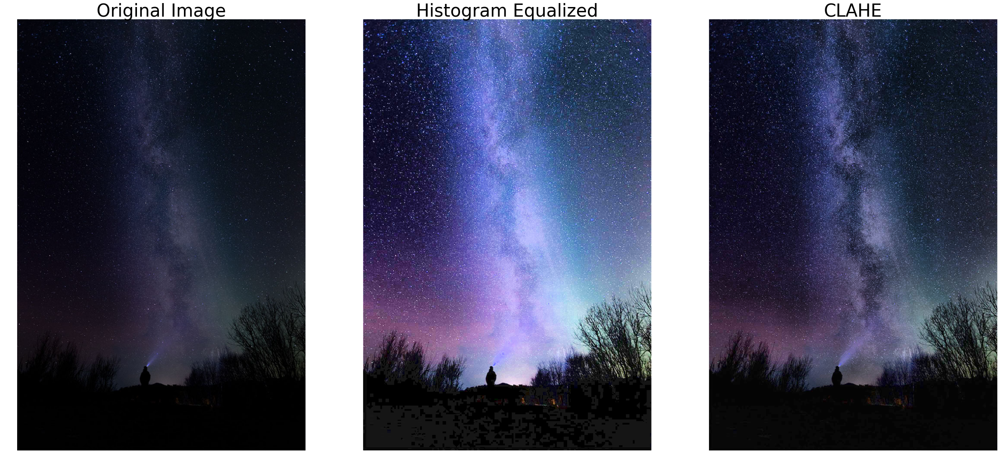

In [16]:
# Read color image
filename = DATA_PATH+"images/night-sky.jpg"
im = cv2.imread(filename)

# Convert to HSV 
imhsv = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)
imhsvCLAHE = imhsv.copy()

# Perform histogram equalization only on the V channel
imhsv[:,:,2] = cv2.equalizeHist(imhsv[:,:,2])

clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(7,7))
imhsvCLAHE[:,:,2] = clahe.apply(imhsvCLAHE[:,:,2])

# Convert back to BGR format
imEq = cv2.cvtColor(imhsv, cv2.COLOR_HSV2BGR)
imEqCLAHE = cv2.cvtColor(imhsvCLAHE, cv2.COLOR_HSV2BGR)


#Display images
plt.figure(figsize=(40,40))

ax = plt.subplot(1,3,1)
plt.imshow(im[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Original Image")
ax.axis('off')


ax = plt.subplot(1,3,2)
plt.imshow(imEq[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Histogram Equalized")
ax.axis('off')

ax = plt.subplot(1,3,3)
plt.imshow(imEqCLAHE[:,:,::-1], vmin=0, vmax=255)
ax.set_title("CLAHE")
ax.axis('off')

## Color Tone Adjustment using Curves
In image enhancement, manipulating color channels using curves is a very important technique. It maps the original colors and brightness of an image to values specified by the user. This is one of the mostly used feature in Photoshop. But Photoshop is manual work, why not write a piece of code for doing that? We will see how we can use this simple yet powerful way of adjusting colors by adding warming and cooling effects to an image.

Consider the curves for the warming filter shown below. The red curve is applied to the Red channel and the Blue curve to the blue channel of the original image. The dotted black line with a slope of 1, is the original mapping. We take some points on the black line and move them. The rest of the points between them are interpolated. If we move the points above the black line as in the case of the Red Channel, the resulting intensity values of red channel increase as given by the y-axis values. Similarly the values decrease for the Blue Channel.

For example, the original intensity value of 50 is increased to 80 for Red channel and decreased to 20 for Blue channel. Thus we get a mapping between the intensity values of the original and the desired output. This mapping is then applied to all the pixels of a given image using a lookup table. The lookup table will store the mapping from the original intensity values to the modified intensity values. As may be evident, the same curve can be applied to all the three channels too.

Let’s see the code and results of the warming and cooling filters. We will also learn how to design instagram-like filters in the following sections.

Note: In the code shared here, we are using piecewise linear curves to keep things simple. It may be desirable to smooth these curves in a real world application.

In [21]:
matplotlib.rcParams['figure.figsize'] = (10.0, 10.0)

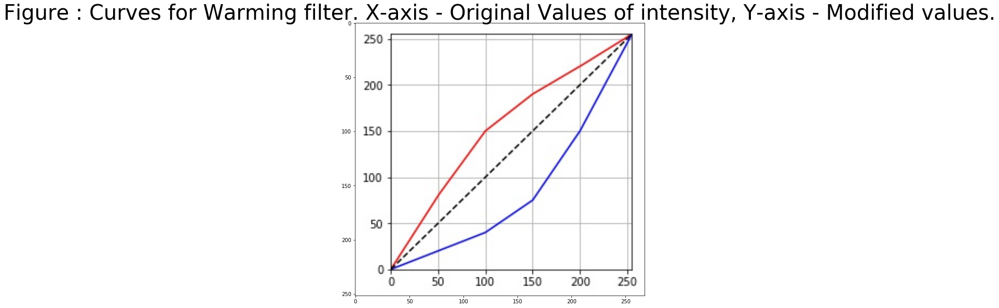

In [22]:
filename = DATA_PATH+"images/warming.jpg"
im = cv2.imread(filename)
plt.title('Figure : Curves for Warming filter. X-axis - Original Values of intensity, Y-axis - Modified values.')
plt.imshow(im[:,:,::-1], vmin=0, vmax=255)


#### Warming Filter
In this program, we will perform color adjustment in B and R channels of the image to produce a cooling effect.

In [23]:
filename = DATA_PATH + "images/girl.jpg"
original = cv2.imread(filename)
img = np.copy(original)

We specify the intensity values in the R and B channels on the original curve ( black dashed line ) that needs to be modified as explained earlier. We create a lookUp table to store the interpolated values so that we get a mapping from the original values to the modified values for each intensity level.

In [24]:
# pivot points for X-Coordinates
originalValue = np.array([0, 50, 100, 150, 200, 255])

# Changed points on Y-axis for each channel
rCurve = np.array([0, 80, 150, 190, 220, 255])
bCurve = np.array([0, 20,  40,  75, 150, 255])

# Create a LookUp Table
fullRange = np.arange(0,256)
rLUT = np.interp(fullRange, originalValue, rCurve )
bLUT = np.interp(fullRange, originalValue, bCurve )

we use the lookUp Table to map the pixel values in the original image to the output image for both the channels and merge the modified channels to get the final output.

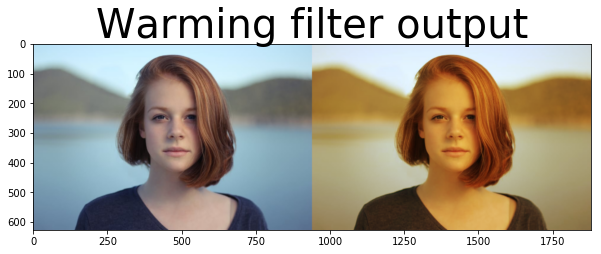

In [25]:
# Get the blue channel and apply the mapping
bChannel = img[:,:,0]
bChannel = cv2.LUT(bChannel, bLUT)
img[:,:,0] = bChannel

# Get the red channel and apply the mapping
rChannel = img[:,:,2]
rChannel = cv2.LUT(rChannel, rLUT)
img[:,:,2] = rChannel

# show and save the ouput
combined = np.hstack([original,img])

plt.imshow(combined[:,:,::-1])
plt.title("Warming filter output")
plt.show()